# Computer Vision - P4

### **Carefully read the file `README.md` as well as the following instructions before start coding.**

## Delivery

Up to **1 point out of 10** will be penalized if the following requirements are not fulfilled:

- Implemented code should be commented.

- The questions introduced in the exercises must be answered.

- Add title to the figures to explain what is displayed.

- Comments need to be in **english**.

- The deliverable must be a file named **P4_Student1_Student2.zip** that includes:
    - The notebook P4_Student1_Student2.ipynb completed with the solutions to the exercises and their corresponding comments.

**Deadline (Campus Virtual): November 20th, 23:00 h** 

==============================================================================================
## Descriptors extraction for object detection, based on template matching, ORB, and HOG
==============================================================================================

In this laboratory we will treat the following main topics:

1) Template matching
    - Normalized Cross-correlation
    - Application to object (eye) detection 

2) Image Descriptors: "Sliding window" and HOG image descriptor
   - Application to object (car) detection

3) Image matching (recognition by correspondance) based on feature extraction (ORB)
    - Application to object (logo) detection
    
In order to complete this practicum, the following concepts need to be understood: template matching, feature localization (Harris, Censure), feature descriptor (HOG,ORB, Sift) methods.

All code should be commented in English. Answers of the questions and comments on the exercises should be given in English too.

It is highly recommendable to structure the code in functions in order to reuse code for different tests and images and make it shorter and more readable. Specially the visualization commands should be encapsulated in separate functions.

## 1 Template matching

1.1 Given the image 'einstein.png' and the template 'eye.png', detect the location of the template in the image comparing the use of:
- euclidean distance (hint: norm() in numpy.linalg).
- normalized cross-correlation (hint: match_template() of skimage.feature).

Hint: you can take as an example, the template matching on the [coin exercise](http://scikit-image.org/docs/dev/auto_examples/features_detection/plot_template.html#sphx-glr-auto-examples-features-detection-plot-template-py) in skimage.
Don't forget to normalize the images (having pixel values between [0,1]) before comparing them.

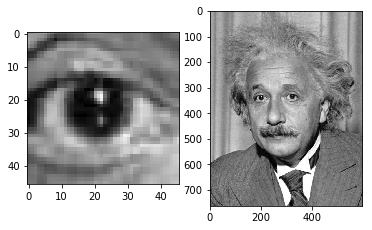

In [19]:
from skimage import io
from matplotlib import pyplot as plt
import numpy as np
%matplotlib inline

plt.subplot(1,2,1)
eye=io.imread('./images/eye.png')
plt.imshow(eye)

plt.subplot(1,2,2)
einstein=io.imread('./images/einstein.png')
plt.imshow(einstein)

plt.show()

Create a function for applying euclidean distance and normalized cross-correlation and display the results in this format:
    
<img src="images_notebook/template_matching.png" width="400" height="120">

**Use titles in all figures to understand what is being displayed.**

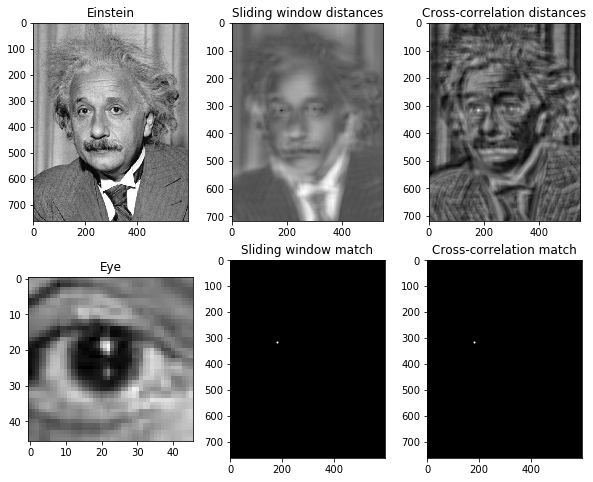

In [20]:
import skimage
from skimage import feature
from skimage import color

def get_matrix_difference(m1, m2):
    """
    Compute euclidean distance between two matrices
    """
    
    return np.linalg.norm(m1 - m2)

def get_dot_product(m1, m2):
    """
    Compute dot product of two matrices
    """
    
    return np.vdot(m1, m2)

def slide_and_apply(template, original, to_apply, step = 1):
    """
    Sliding window method for matching a template in an image.
    """
    
    # Transform images to grayscale
    template = color.rgb2gray(template)
    original = color.rgb2gray(original)
    
    # Transform images to float
    template = skimage.img_as_float(template)
    original = skimage.img_as_float(original)
    result = np.zeros((original.shape[0] - template.shape[0], original.shape[1] - template.shape[1]))
    
    # Iterate over original image
    for i in range(0, original.shape[0] - template.shape[0], step):
        for j in range(0, original.shape[1] - template.shape[1], step):
            
            # Generate a cutout of the shape of the template from the original image
            cutout = original[i:i + template.shape[0], j:j + template.shape[1]]
            
            # Save euclidean distance from cutout to template at this position to result matrix
            result[i, j] = to_apply(template, cutout)
          
    return result

def sliding_window(template, original, step = 1):
    """
    Sliding window method for matching a template in an image.
    """
    
    # Slide and apply applies the specified function iteratively to the whole image
    return slide_and_apply(template, original, get_matrix_difference)
            
def normalized_cross_correlation(template, original):
    """
    Normalized cross-correlation method for matching a template in an image.
    """
    
    # Transform images to grayscale
    template = color.rgb2gray(template)
    original = color.rgb2gray(original)
    
    # Transform images to float
    template = skimage.img_as_float(template)
    original = skimage.img_as_float(original)
    
    result = feature.match_template(original, template)
    return result

def show_matching_results(eye, einstein):
    """
    Compute template matching and display results 
    """
    
    sliding_window_result = sliding_window(eye, einstein)
    cross_correlation_result = normalized_cross_correlation(eye, einstein)

    # Retrieve indices corresponding to minimum value in sliding window result image
    sliding_window_indices = np.unravel_index(np.argmin(sliding_window_result), sliding_window_result.shape)

    # Retrieve indices corresponding to maximum value in sliding window result image
    cross_correlation_indices = np.unravel_index(np.argmax(cross_correlation_result), cross_correlation_result.shape)

    # Display images
    f, axarr = plt.subplots(ncols=3, nrows=2,figsize=(10,8))

    # Original
    axarr[0, 0].imshow(einstein, cmap = "gray")
    axarr[0, 0].set_title('Einstein')

    axarr[1, 0].imshow(eye, cmap = "gray")
    axarr[1, 0].set_title('Eye')

    # Sliding window result
    axarr[0, 1].imshow(sliding_window_result, cmap = "gray")
    axarr[0, 1].set_title('Sliding window distances')

    axarr[1, 1].imshow(np.zeros((einstein.shape[0], einstein.shape[1])), cmap = "gray")
    axarr[1, 1].plot(sliding_window_indices[1], sliding_window_indices[0], "o", 
                     markeredgecolor = "w", markerfacecolor = "none", markersize = 1)
    axarr[1, 1].set_title('Sliding window match')

    # Cross-correlation result
    axarr[0, 2].imshow(cross_correlation_result, cmap = "gray")
    axarr[0, 2].set_title('Cross-correlation distances')

    axarr[1, 2].imshow(np.zeros((einstein.shape[0], einstein.shape[1])), cmap = "gray")
    axarr[1, 2].plot(cross_correlation_indices[1], cross_correlation_indices[0], "o", 
                     markeredgecolor = "w", markerfacecolor = "none", markersize = 1)
    axarr[1, 2].set_title('Cross-correlation match')

    plt.show()
    
    # Return distance matrices
    return ({
            "matrix1" : sliding_window_result,
            "matrix2" : cross_correlation_result,
            "result1" : sliding_window_indices,
            "result2" : cross_correlation_indices
        })
    
original = show_matching_results(eye, einstein)

How does the result of the template matching change if the image changes its contrast (for example if you make it clearer or darker)? To this purpose, read the images "einstein_br.png" and "einstein_mask.png".

Visualize the normalized cross-correlation image between the template and the image as well as this very same image in a binarized form in order to show where is the minimal distance between the template and the image. 

Use titles of the figures to explain what is displayed.


1.2 Display the results on `einstein_br.png`:

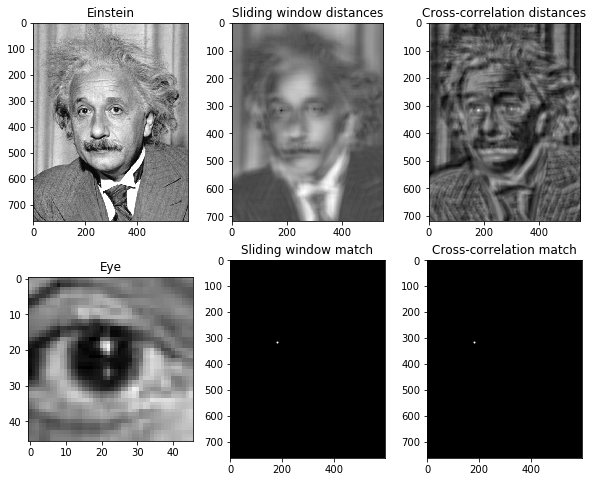

In [21]:
einstein_br = io.imread('./images/einstein_br.png')
br = show_matching_results(eye, einstein_br)

1.3 Display the results on `einstein_mask.png`:

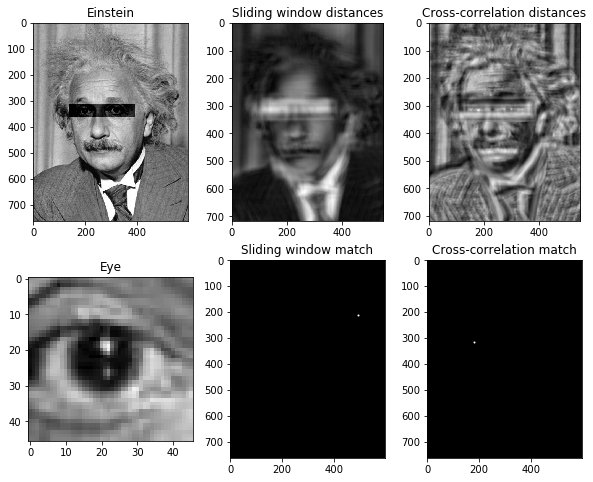

In [22]:
einstein_mask = io.imread('./images/einstein_mask.png')
mask = show_matching_results(eye, einstein_mask)

1.4.
* How does the minimum distance between the template and the image change? 
* What are the minimal distance pixels in the correlation images? 
* What are the distances between the template and the image around the eyes of the image? 

**Answers**

a)

The distance between the template and the image is defined using the norm of the **difference between a subset (of *template.shape* size) of the original image and the template** at any given point. 

As we can see in our result matrix (which displays the difference to the template at each coordinate in our image), this difference *is lower the more similar a section of the image is to our template*. Therefore, logically, **the difference will be the lowest when the sub-section of the image at a point matches our template**.

- **einstein_br:** Increasing the brightness of the entire original image increases the distance evenly at all points, since all pixels of the image are modified equally. **This increase in difference is due to our template being now slightly darker than the image**.


- **einstein_mask:** This case is special in that it dramatically modifies a portion of the original image. As we can see, the difference is now too dramatic for the sliding window method to provide a valuable result - **the difference in brightness is now so dramatic that *any other unmodified section of the original image* happens to be more similar to our template**.

On the other hand, **the cross-correlation method, which is invariant to brighness, provides the same result** in all cases.

b), c)

The minimal distance pixels, and their corresponding values, are the following:

In [7]:
print ("Original minimal distance pixel using sliding window:", original["result1"])
print ("With value:", original["matrix1"][original["result1"]])

print ("\nOriginal minimal distance pixel using cross-correlation:", original["result2"])
print ("With value:", original["matrix2"][original["result2"]])

Original minimal distance pixel using sliding window: (316, 178)
With value: 1.98953045954

Original minimal distance pixel using cross-correlation: (316, 178)
With value: 0.976817


As we can see, **both methods returned the same match coordinates**, even if the final values are different due to the different approaches.

The values surrounding the match coordinates are not significative, since **proximity to the match point does not necessarily imply hihger similarity to the template**. For example, the cross-correlation value at (310, 170) is wildly different to our result:

In [8]:
print (original["matrix2"][(310, 170)])

0.0586664


1.5 How does the result of the template matching change if instead the template is the one that changes its contrast (for example if you make it clearer or darker)? To this purpose, use the 'eye_br.png' template.

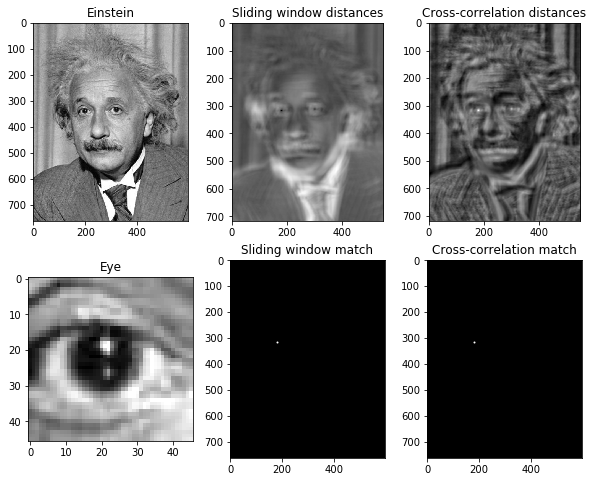

In [9]:
eye_br = io.imread('./images/eye_br.png')
br2 = show_matching_results(eye_br, einstein)

**Answer**

This case is similar to the **einstein_br** one, as, just like before, the sliding window distances have increased evenly throughout the whole image as result of comparing to a *slightly brighter* template.

1.6 Check how the result changes if the template is rotated. Visualize the template and its rotation by 10º, 15º and 20º. Obtain again the template matching using the Euclidean distance and normalized cross-correlation.
Help: use the function rotate() in skimage.transform

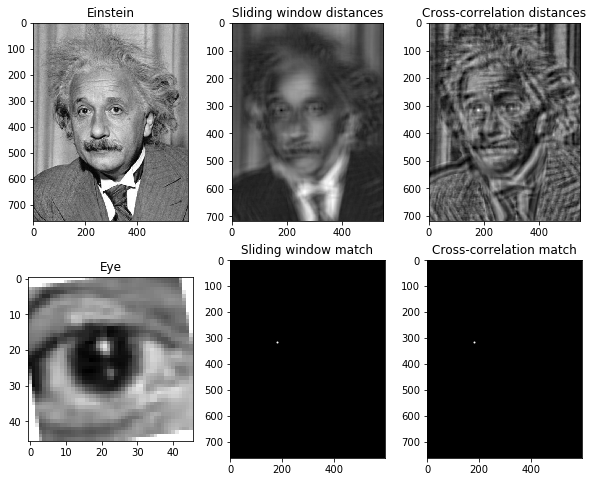

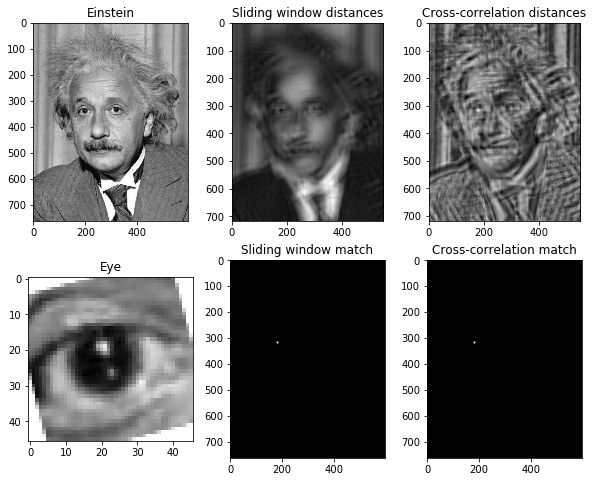

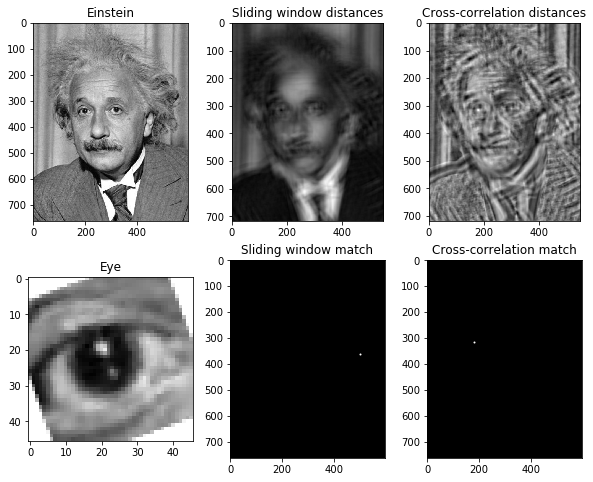

In [23]:
from skimage.transform import rotate

# Generate template rotated by 10, 15 and 20 degrees
eye10 = rotate(eye, 10)
eye15 = rotate(eye, 15)
eye20 = rotate(eye, 20)

# Display results using rotated templates
eye10_results = show_matching_results(eye10, einstein)
eye15_results = show_matching_results(eye15, einstein)
eye20_results = show_matching_results(eye20, einstein)

** Answer **

As we can see from the results above, **the sliding window distances don't change significantly** after rotating the template, still resulting in the same match for the 10º and 15º rotations. It is only when we rotate the template 20º or more that the minimum distance coordinates vary dramatically.

The **cross-correlation result, on the other hand, still manages to output the correct result** after each rotation.

1.7 Comment what is the template matching process, what advantages and disadvantages it has, how sensible is to image deformation in photometric and spatial dimensions, what parameters it has and which measure for image comparisons works better.

**Answer**

**Template matching** consists on the location of a given template inside a bigger picture. In this case, we use **two different approaches:** the *sliding window* method, which moves the pattern across the image comparing it against the section it's covering; and the *normalized cross-correlation* method, which measures the similarity of the pattern and the image calculating the displacement of one relative to the other.

**The sliding window method** is largely invariant to photometric changes applied evenly to the whole image (as explained earlier), but not to localized changes. It is *not*, however, invariant to spatial changes such as rotation.

**The normalized cross-correlation method**, on the other hand, providas invariability to both photometric and invariant changes, while also being a more efficient algorithm and providing better results.

# 2 Histogram of Oriented Gradients


The Histogram of Oriented Gradients (HOG) feature descriptor is classical image descriptor for object detection.

Given the image 'car_template.png' and the folder 'cars', apply the HOG descriptor in order to detect where there is a car in the images in the folder 'car'. To this purpose, apply the "sliding window" technique.

2.1 Read the car template ('car_template.png') and obtain its HOG descriptor. Visualize it. [Help](http://scikit-image.org/docs/dev/auto_examples/features_detection/plot_hog.html#sphx-glr-auto-examples-features-detection-plot-hog-py) 

Hint: the HOG detector function is in the skimage.feature library. 

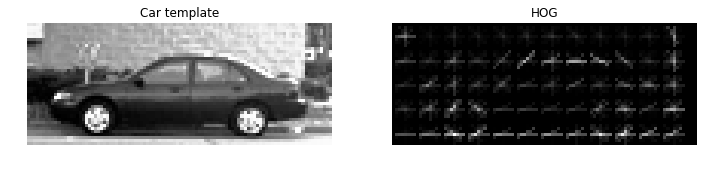

In [11]:
from skimage.feature import hog
from skimage import exposure

# Read image
car_template = io.imread('./images/car_template.png')

# Compute HOG and corresponding descriptor of image
descriptor, car_hog = hog(car_template, orientations=8, pixels_per_cell=(8, 8), 
                    cells_per_block=(1, 1), visualise=True)

# Display results
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))

ax1.axis('off')
ax1.imshow(car_template, cmap="gray")
ax1.set_title("Car template")

ax2.axis('off')
ax2.imshow(car_hog, cmap="gray")
ax2.set_title("HOG")
plt.show()

2.2 Apply the HOG descriptor on the complete set of images.

a) Read images from the folder "car", slide a window on each image, obtain the HOG descriptor and compare to the HOG descriptor of the car template. **In order to accelerate algorithm execution, you must apply a sliding window with a step of X pixels both vertically and horizontally (e.g. X=5).**

b) Visualize the location in the image that is the most similar to the car template. What distance will you use to compare both HOG descriptors of the car template and the image region? Compare if there is any difference in their results.

Display the results of every car detection and for each distance following this format:

<img src="images_notebook/hog.png" width="800" height="100">

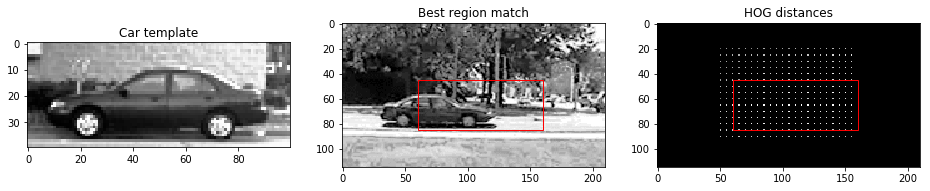

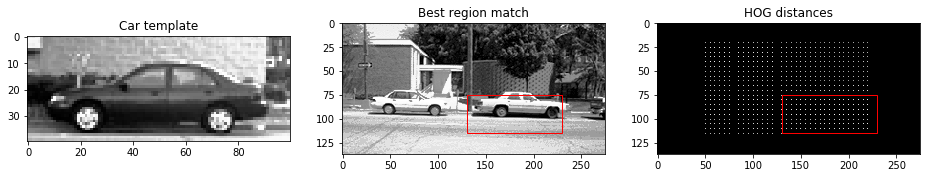

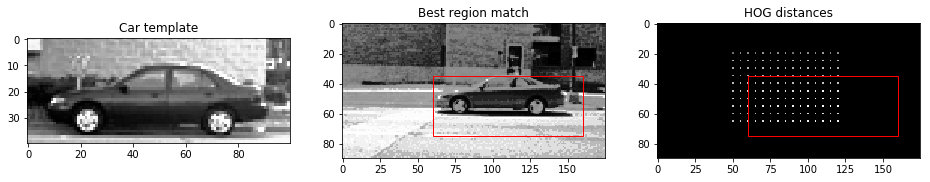

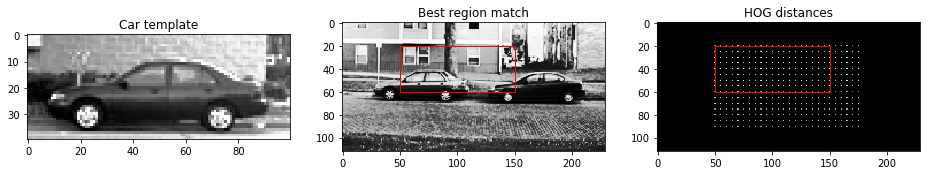

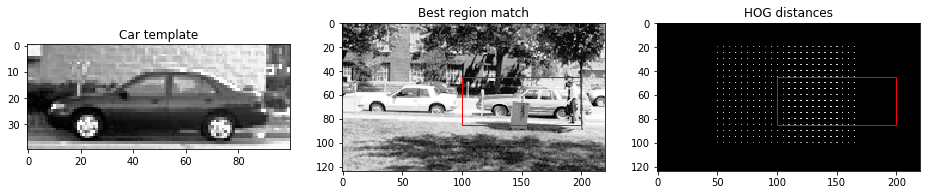

...

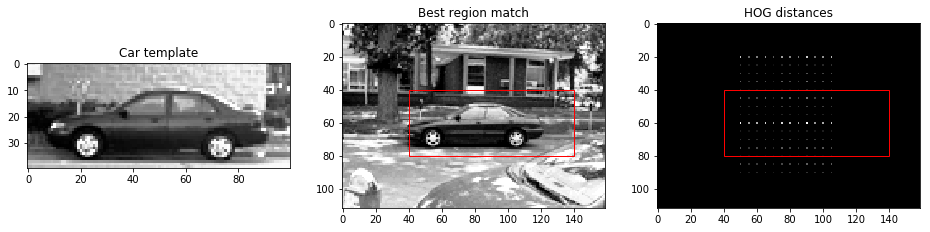

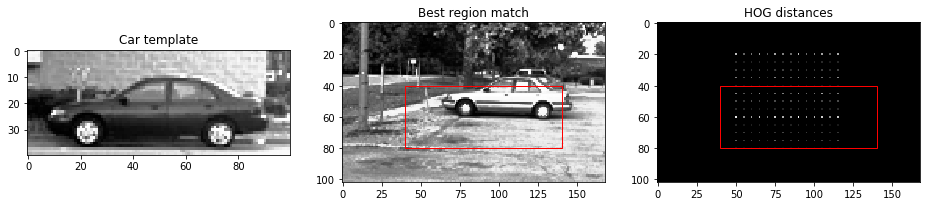

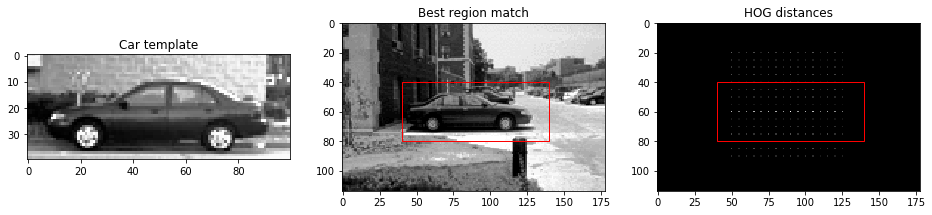

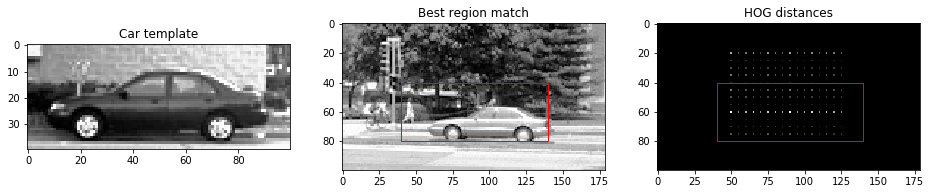

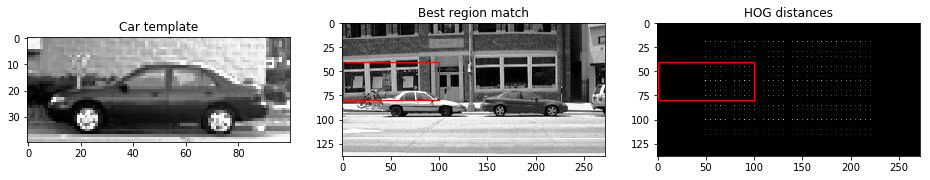

KeyboardInterrupt: 

In [12]:
import matplotlib.patches as patches
import math

cars = io.ImageCollection('images/TestImages/*.pgm')

def match_cars(method):

    for c in cars:

        # Compute HOG of image
        h = hog(c, orientations=8, pixels_per_cell=(8, 8), cells_per_block=(1, 1), visualise=True)[1]

        # Apply sliding window between original car HOG and
        # current image HOG to find distance matrix (step = 5)
        result = slide_and_apply(car_hog, h, method, 5)

        # Add black margins to distance matrix to represent
        # proportional to entire image
        result_big = np.zeros(c.shape)
        padding = (math.floor((result_big.shape[0] - result.shape[0]) / 2), 
                   math.floor((result_big.shape[1] - result.shape[1]) / 2))

        result_big[
            padding[0]:result_big.shape[0] - padding[0],
            padding[1]:result_big.shape[1] - padding[1]
                  ] = result

        # Retrieve indices corresponding to minimum value in sliding window result image
        sliding_window_indices = np.unravel_index(np.argmax(result), result.shape)

        # Display images
        f, axarr = plt.subplots(ncols=3, nrows=1,figsize=(16,8))

        # Car template
        axarr[0].imshow(car_template, cmap="gray")
        axarr[0].set_title('Car template')

        # Best region match
        axarr[1].imshow(c, cmap = "gray")
        axarr[1].set_title('Best region match')
        axarr[1].add_patch(patches.Rectangle(sliding_window_indices[::-1], car_hog.shape[1], car_hog.shape[0], linewidth=1,edgecolor='r',facecolor='none'))

        # HOG distances
        axarr[2].imshow(result_big, cmap = "gray")
        axarr[2].set_title('HOG distances')
        axarr[2].add_patch(patches.Rectangle(sliding_window_indices[::-1], car_hog.shape[1], car_hog.shape[0], linewidth=1,edgecolor='r',facecolor='none'))

        plt.show()
        
# Display matches using matrix distance
match_cars(get_matrix_difference)

# Display matches using dot product
match_cars(get_dot_product)

2.3 Count on how many images were the cars detected correctly and discuss the algorithm failures. What do you think can be the reasons for the failure?

Discuss what is the HOG descriptor, what are the parameters of the algorithm, which are the optimal values for the car detection testing several values of the parameters up to your criterion. Do you see any advantages of the HOG-based object detector compared to the template-based object detection? (The answer should be up to 10-15 lines).

As we can see, **out of all of the 170 images, around 155 returned the expected result** and detected what was indeed a car, resulting in a **~0.91176 success rate**.

# 3 ORB feature detector and binary descriptor

Let us consider the problem of feature extraction that contains two subproblems: 
- feature location, 
- image feature description.

In theory classes, we saw two feature extraction methods: SIFT and ORB. Let us focus on ORB.

Analyse if ORB is  scale and rotation invariant, a property that is very important for real-time applications.

**Hint:** `ORB` is a function within the module `skimage.feature`
                             
**Help**: We suggest to have a look at the [ORB example](http://scikit-image.org/docs/dev/auto_examples/features_detection/plot_orb.html) how to compute the ORB descriptors and find the descriptors match. You can use the function match_descriptors from `skimage.feature` module in order to compute and show the similar detected descriptors of the given images. 

3.1 Detect the correspondences between the model image `starbucks.jpg` with the scene image `starbucks6.jpg`. You can adapt the code from the [ORB example](http://scikit-image.org/docs/dev/auto_examples/features_detection/plot_orb.html) above. Define the algorithm in terms of functions in order to be able to apply it on different images. Comment the code in detail.

**Hint: If the function plot_matches() gives you an error you can use the plot_matches_aux() at the end of this file.**

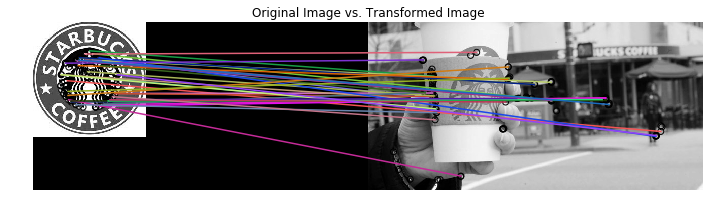

In [13]:
from skimage import data
from skimage import transform as tf
from skimage.feature import (match_descriptors, corner_harris,
                             corner_peaks, ORB, plot_matches)
from skimage.color import rgb2gray
import matplotlib.pyplot as plt

from skimage import color

# Read image
starbucks = io.imread('./images/starbucks.jpg')
starbucks6 = io.imread('./images/starbucks6.jpg')

def get_matches(image1, image2, n_keypoints=100):
    
    # Obtain ORB
    descriptor_extractor = ORB(n_keypoints=n_keypoints)
    
    # Obtain image keypoints and descriptors
    descriptor_extractor.detect_and_extract(image1)
    
    image1_keypoints = descriptor_extractor.keypoints
    image1_descriptor = descriptor_extractor.descriptors
    
    descriptor_extractor.detect_and_extract(image2)

    image2_keypoints = descriptor_extractor.keypoints
    image2_descriptor = descriptor_extractor.descriptors

    # Match keypoints
    matches = match_descriptors(image1_descriptor, image2_descriptor, cross_check=True)
    
    return (image1_keypoints, image2_keypoints, matches)

def show_orb(image1, image2, n_keypoints=100):

    # Transform image to float and grayscale
    image1 = rgb2gray(skimage.img_as_float(image1))
    image2 = rgb2gray(skimage.img_as_float(image2))
    
    # Display
    fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(12, 6))
    plt.gray()

    matches = get_matches(image1, image2)
    plot_matches(ax, image1, image2, matches[0], matches[1], matches[2])

    ax.axis('off')
    ax.set_title("Original Image vs. Transformed Image")

    plt.show()
    
show_orb(starbucks, starbucks6)

3.2 Repeate the experiment comparing the "starbucks.jpg" image as a model, and showing its matches to all Starbucks images, sorting them based on their similarity to the model. Comment when does the algorithm work better. 

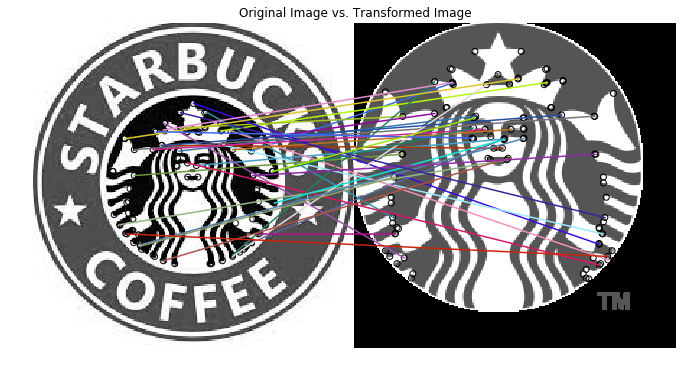

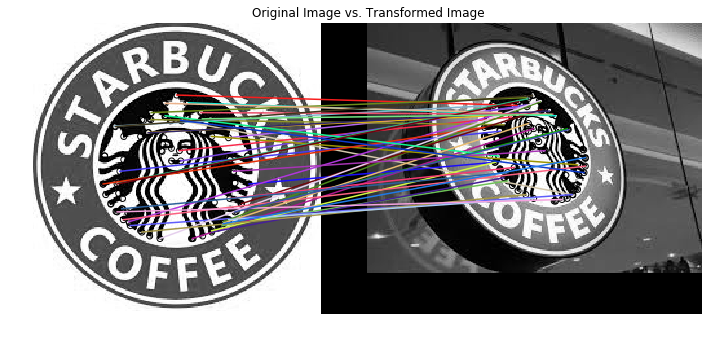

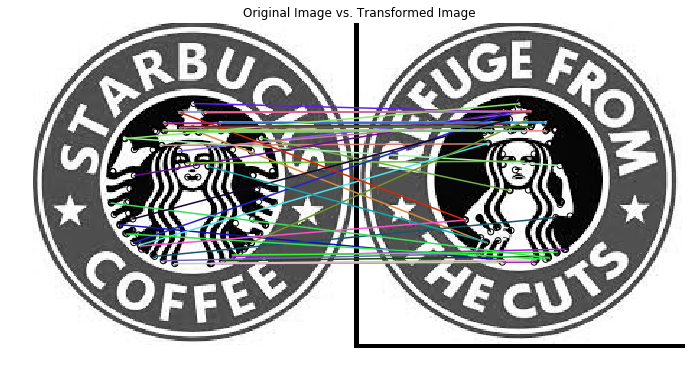

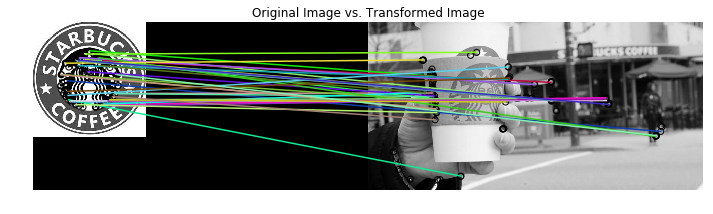

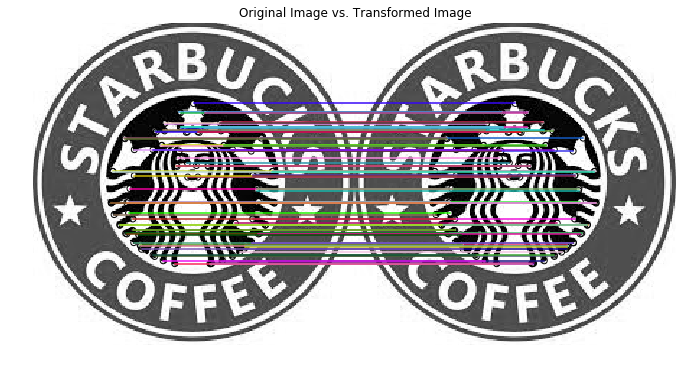

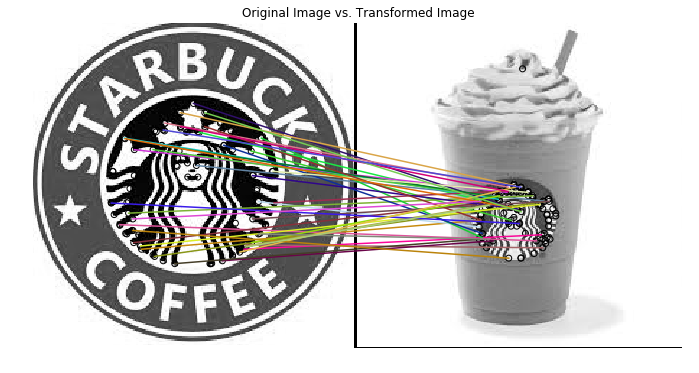

In [14]:
starbucks_images = io.ImageCollection('./images/starbucks*')

for img in starbucks_images:
    show_orb(starbucks, img)

3.3 Repeate the experiment in 3.2: 
- Changing the orientation of the model image by rotating it and comparing it with its original version. Help: you can use the rotate() function from skimage.transform 
- Change the scale and orientation of the scene image and compare it with the model image.

Help: To do so, you can use the function given below as example:

import transform as tf
rotationdegrees = 180
img_rotated = tf.rotate(image2transform, rotationdegrees)

or

tform = tf.AffineTransform(scale=(1.2, 1.2), translation=(0, -100))
img_transformed = tf.warp(image2transform, tform)

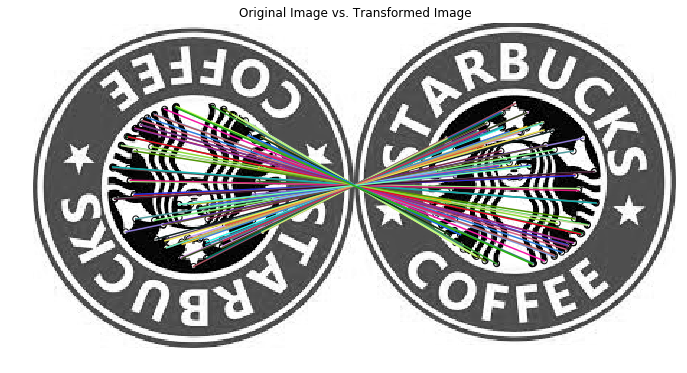

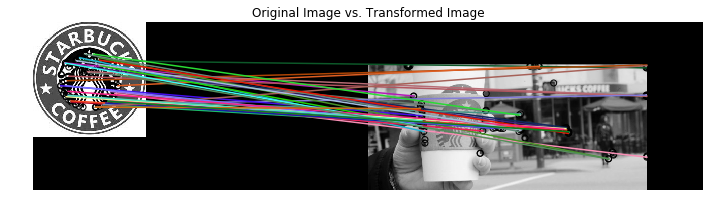

In [24]:
# Rotated model image
starbucks_rotated = rotate(starbucks, 180)

# Rotated and rescaled scene image
transformation = tf.AffineTransform(scale=(1.2,1.2), translation=(0,-100))
starbucks6_transformed = tf.warp(starbucks6, transformation)

# Show ORB results
show_orb(starbucks_rotated, starbucks)
show_orb(starbucks, starbucks6_transformed)

3.4 **(Optional)** Repeat the experiment (3.1 to 3.3) with a new group of images. You could use Coca-Cola advertisements or from another famous brand, easily to find on internet.



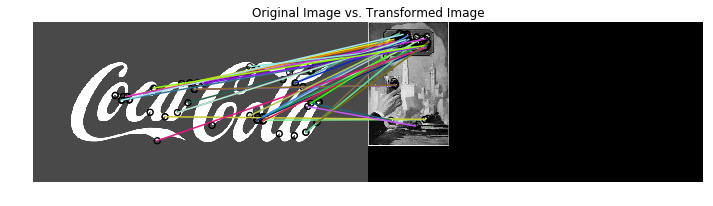

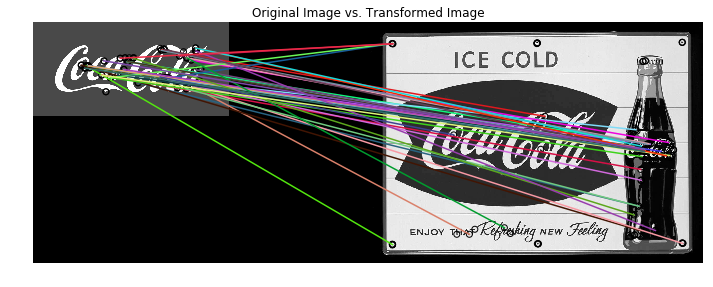

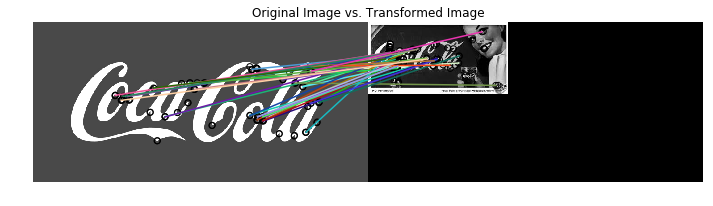

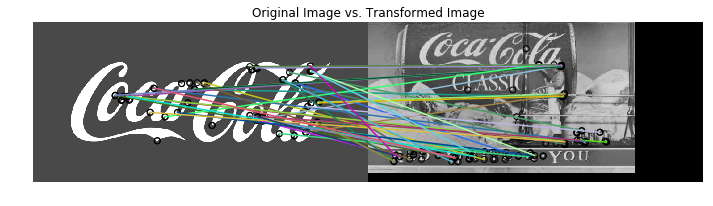

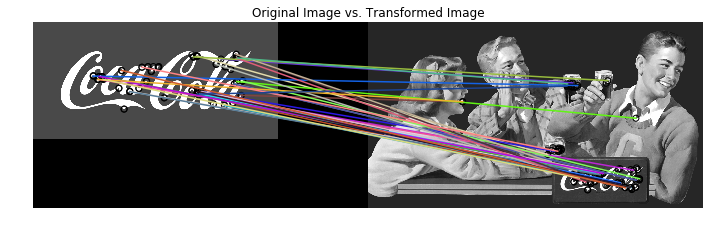

In [18]:
# Read image
coke = io.imread('./extra_images/coke.jpg')

coke_ads = io.ImageCollection('./extra_images/coke_ad*')

for ad in coke_ads:
    show_orb(coke, ad)

3.5 Analysis of the applied techniques and results

- What are the advantages of the ORB object detection with respect to the HOG and template object detector?

- What would happen if you analyse an image that does not contain the Starbucks logo? 

- Could you think of ways of defining a quality measure for the correspondance between two images? (no need of implementing it) 

**Answers**

a) **ORB detection** can not only detect the location of a template in an image, but also extract its distinctive features and match them adequately in both images.

b) The distinctive features of both images would be extracted, but **matched in the most approximate (albeit senseless) way**.

c) One proposal would be to **measure the relative position of distinctive features** among themselves in both images and compare them. A simple approach would be to find the average position (corresponding to the geometrical center of all features) and variance of all features.

### Appendix

In [ ]:
# In case the plot_matches() function gives you some problems, you can use the following one:

from skimage.util import img_as_float
import numpy as np

def plot_matches_aux(ax, image1, image2, keypoints1, keypoints2, matches,
                 keypoints_color='k', matches_color=None, only_matches=False):
    """Plot matched features.
    Parameters
    ----------
    ax : matplotlib.axes.Axes
        Matches and image are drawn in this ax.
    image1 : (N, M [, 3]) array
        First grayscale or color image.
    image2 : (N, M [, 3]) array
        Second grayscale or color image.
    keypoints1 : (K1, 2) array
        First keypoint coordinates as ``(row, col)``.
    keypoints2 : (K2, 2) array
        Second keypoint coordinates as ``(row, col)``.
    matches : (Q, 2) array
        Indices of corresponding matches in first and second set of
        descriptors, where ``matches[:, 0]`` denote the indices in the first
        and ``matches[:, 1]`` the indices in the second set of descriptors.
    keypoints_color : matplotlib color, optional
        Color for keypoint locations.
    matches_color : matplotlib color, optional
        Color for lines which connect keypoint matches. By default the
        color is chosen randomly.
    only_matches : bool, optional
        Whether to only plot matches and not plot the keypoint locations.
    """

    image1 = img_as_float(image1)
    image2 = img_as_float(image2)

    new_shape1 = list(image1.shape)
    new_shape2 = list(image2.shape)

    if image1.shape[0] < image2.shape[0]:
        new_shape1[0] = image2.shape[0]
    elif image1.shape[0] > image2.shape[0]:
        new_shape2[0] = image1.shape[0]

    if image1.shape[1] < image2.shape[1]:
        new_shape1[1] = image2.shape[1]
    elif image1.shape[1] > image2.shape[1]:
        new_shape2[1] = image1.shape[1]

    if new_shape1 != image1.shape:
        new_image1 = np.zeros(new_shape1, dtype=image1.dtype)
        new_image1[:image1.shape[0], :image1.shape[1]] = image1
        image1 = new_image1

    if new_shape2 != image2.shape:
        new_image2 = np.zeros(new_shape2, dtype=image2.dtype)
        new_image2[:image2.shape[0], :image2.shape[1]] = image2
        image2 = new_image2

    image = np.concatenate([image1, image2], axis=1)

    offset = image1.shape

    if not only_matches:
        ax.scatter(keypoints1[:, 1], keypoints1[:, 0],
                   facecolors='none', edgecolors=keypoints_color)
        ax.scatter(keypoints2[:, 1] + offset[1], keypoints2[:, 0],
                   facecolors='none', edgecolors=keypoints_color)

    ax.imshow(image, interpolation='nearest', cmap='gray')
    ax.axis((0, 2 * offset[1], offset[0], 0))

    for i in range(matches.shape[0]):
        idx1 = matches[i, 0]
        idx2 = matches[i, 1]

        if matches_color is None:
            color = np.random.rand(3)
        else:
            color = matches_color

        ax.plot((keypoints1[idx1, 1], keypoints2[idx2, 1] + offset[1]),
                (keypoints1[idx1, 0], keypoints2[idx2, 0]),
                '-', color=color)